# Atmospheric Water Vapor Lake project

In [84]:
from os import listdir
from os.path import isfile, join

In [85]:
import geocat.datafiles as gdf
import geocat.viz as gv

ConnectionError: HTTPSConnectionPool(host='github.com', port=443): Max retries exceeded with url: /NCAR/GeoCAT-datafiles/raw/main/registry.txt (Caused by NewConnectionError('<urllib3.connection.HTTPSConnection object at 0x7f0297b3f490>: Failed to establish a new connection: [Errno 101] Network is unreachable'))

In [86]:
import cartopy.crs as ccrs
import matplotlib.animation as animation

import numpy as np
import xarray as xr
from matplotlib import pyplot as plt
from IPython.display import HTML
plt.rcParams["animation.html"] = "jshtml"

In [87]:
import pandas as pd

In [88]:
from scipy.stats import binned_statistic

# September: 
## Dataset output look up, basic plots

### MERRA2 

In [89]:
try_file_minimal='/home/snigdha/Documents/LAKEBYLAKE/MERRA2_2D/MINIMAL/2014_04_12_21_lat5p095N.M2_min2D_distance.nc'

In [90]:
try_dataset_minimal = xr.open_dataset(try_file_minimal)

In [91]:
try_dataset_minimal

<xarray.Dataset>
Dimensions:            (lat: 44, lon: 72, time: 172)
Coordinates:
  * time               (time) datetime64[ns] 2014-04-05T17:30:00 ... 2014-04-...
  * lat                (lat) float64 -4.0 -3.5 -3.0 -2.5 ... 16.0 16.5 17.0 17.5
  * lon                (lon) float64 44.38 45.0 45.62 46.25 ... 87.5 88.12 88.75
Data variables:
    prectot            (time, lat, lon) float32 ...
    tqv                (time, lat, lon) float32 ...
    distance           (time, lat, lon) float32 ...
    dir_from_centroid  (time, lat, lon) float32 ...
Attributes:
    title:        MERRA-2 tavg1_2d_flx_Nx: 2d,1-Hourly,Time-Averaged,Single-L...
    Conventions:  COARDS\nGrADS
    dataType:     Grid
    history:      Wed May 24 22:31:24 GMT 2023 : imported by GrADS Data Serve...

In [92]:
running_avg_data = try_dataset_minimal.rolling(time=3)

In [93]:
running_avg_data

DatasetRolling [time->3]

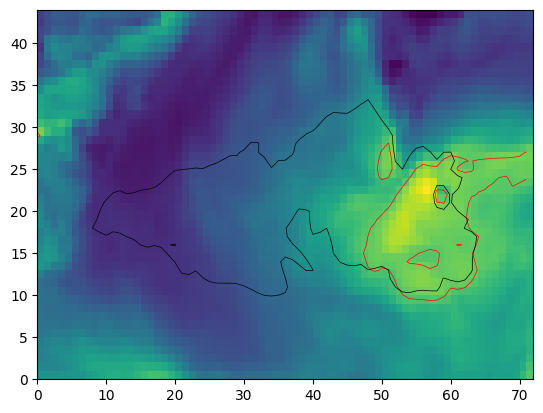

In [94]:
plt.pcolormesh(try_dataset_minimal.tqv[0,:,:])
plt.contour(try_dataset_minimal.tqv[0,:,:],colors='r', linewidths=0.5, levels = [55])
plt.contour(try_dataset_minimal.distance[0,:,:],colors='black', linewidths=0.5, levels = [0])

### IMERG

In [14]:
imerg_path = '/home/snigdha/Documents/LAKEBYLAKE/IMERG/'
list_of_imerg_files = [f for f in listdir(imerg_path) if isfile(join(imerg_path, f))]

In [15]:
list_of_imerg_files

['2014_04_12_21_lat5p095N.IMERGcal_halfhourly.nc',
 '2014_04_12_21_lat5p095N.IMERGhq_halfhourly.nc',
 '2014_04_12_21_lat5p095N_IMERG_precipc_3hourly.nc',
 '2014_04_12_21_lat5p095N_IMERG_precipc_hourly.nc',
 '2014_04_17_06_lat6p223S_IMERG_precipc_3hourly.nc',
 '2014_04_17_06_lat6p223S_IMERG_precipc_hourly.nc',
 '2014_04_19_22_lat7p255S_IMERG_precipc_3hourly.nc',
 '2014_04_19_22_lat7p255S_IMERG_precipc_hourly.nc',
 '2014_05_11_15_lat4p404N_IMERG_precipc_3hourly.nc',
 '2014_05_11_15_lat4p404N_IMERG_precipc_hourly.nc',
 '2014_05_11_18_lat2p131S_IMERG_precipc_3hourly.nc',
 '2014_05_11_18_lat2p131S_IMERG_precipc_hourly.nc',
 '2015_03_21_09_lat5p130N_IMERG_precipc_3hourly.nc',
 '2015_03_21_09_lat5p130N_IMERG_precipc_hourly.nc',
 '2015_03_21_17_lat5p987N.IMERGcal_halfhourly.nc',
 '2015_03_21_17_lat5p987N.IMERGhq_halfhourly.nc',
 '2015_03_21_17_lat5p987N_IMERG_precipc_3hourly.nc',
 '2015_03_21_17_lat5p987N_IMERG_precipc_hourly.nc',
 '2015_04_29_21_lat5p196N_IMERG_precipc_3hourly.nc',
 '2015_04_

In [16]:
try_dataset_imerg = xr.open_dataset(imerg_path + list_of_imerg_files[9])

In [17]:
try_dataset_imerg 

<xarray.Dataset>
Dimensions:  (lat: 333, lon: 282, time: 223)
Coordinates:
  * time     (time) datetime64[ns] 2014-05-02T09:00:00 ... 2014-05-11T15:00:00
  * lat      (lat) float64 -19.45 -19.35 -19.25 -19.15 ... 13.55 13.65 13.75
  * lon      (lon) float64 33.15 33.25 33.35 33.45 ... 60.95 61.05 61.15 61.25
Data variables:
    precipc  (time, lat, lon) float32 ...

## Task 1:
### Making animations of CVW, 54mm contour, and distance field for all cases in 2014-2018 dataset
### File Path : '/home/snigdha/Documents/LAKEBYLAKE/MERRA2_2D/MINIMAL/'

In [18]:
minimal_cases_path = '/home/snigdha/Documents/LAKEBYLAKE/MERRA2_2D/MINIMAL/'
list_of_minimal_cases = [f for f in listdir(minimal_cases_path) if isfile(join(minimal_cases_path, f))]

In [19]:
list_of_minimal_cases

['2014_04_12_21_lat5p095N.M2_min2D_distance.nc',
 '2014_04_17_06_lat6p223S.M2_min2D_distance.nc',
 '2014_04_19_22_lat7p255S.M2_min2D_distance.nc',
 '2014_05_11_15_lat4p404N.M2_min2D_distance.nc',
 '2014_05_11_18_lat2p131S.M2_min2D_distance.nc',
 '2015_03_21_09_lat5p130N.M2_min2D_distance.nc',
 '2015_03_21_17_lat5p987N.M2_min2D_distance.nc',
 '2015_04_29_21_lat5p196N.M2_min2D_distance.nc',
 '2015_04_30_02_lat0p276N.M2_min2D_distance.nc',
 '2015_04_30_17_lat4p330S.M2_min2D_distance.nc',
 '2015_05_01_17_lat2p027N.M2_min2D_distance.nc',
 '2015_05_01_21_lat7p053N.M2_min2D_distance.nc',
 '2015_05_05_01_lat0p460S.M2_min2D_distance.nc',
 '2015_05_05_07_lat6p890S.M2_min2D_distance.nc',
 '2015_05_05_21_lat0p238S.M2_min2D_distance.nc',
 '2015_05_06_21_lat5p111N.M2_min2D_distance.nc',
 '2015_05_07_03_lat6p414S.M2_min2D_distance.nc',
 '2015_09_17_21_lat3p507N.M2_min2D_distance.nc',
 '2016_04_10_23_lat8p819S.M2_min2D_distance.nc',
 '2016_04_15_08_lat5p477S.M2_min2D_distance.nc',
 '2016_04_29_17_lat1

In [20]:
def animate_field(field_number, variable):
    dataset = xr.open_dataset(minimal_cases_path + list_of_minimal_cases[field_number])
    
    lons = dataset['lon']
    lats = dataset['lat']
  
    fig = plt.figure(figsize=(10, 8))
    ax = plt.axes(projection=ccrs.LambertCylindrical(central_longitude=0.0))
    ax.set_extent([lons.min(), lons.max(), lats.min(), lats.max()], ccrs.PlateCarree())
    ax.coastlines(linewidths=0.5)
  
    mesh = ax.pcolormesh(lons, lats, dataset[variable][0, :, :].data, transform=ccrs.PlateCarree())

    def animate(i):
        mesh.set_array(dataset[variable][i, :, :].data.flatten())
  
    anim = animation.FuncAnimation(fig, animate, frames=79, interval=500)
    anim.save('animate_1.gif', writer='pillow', fps=5)
    return HTML(anim.to_jshtml())


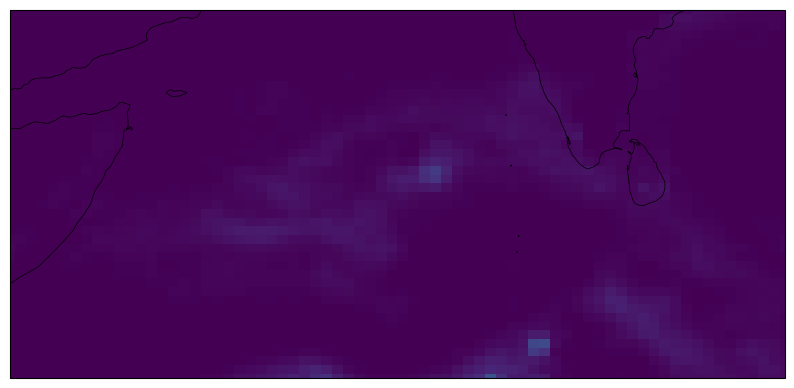

In [21]:
animate_field(0,'prectot')

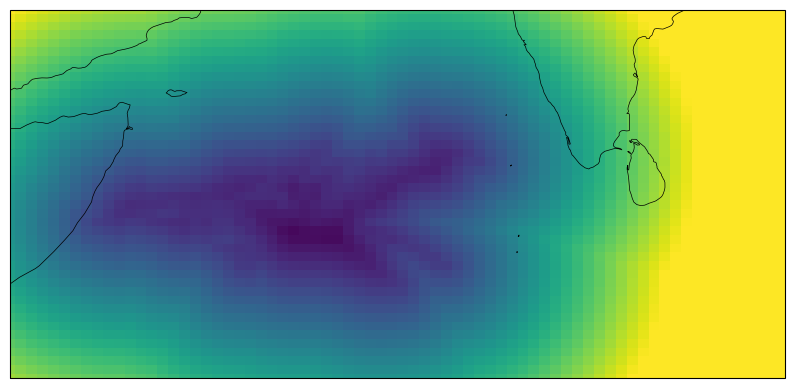

In [22]:
animate_field(0,'distance')

In [23]:
field_number = 0
dataset = xr.open_dataset(minimal_cases_path + list_of_minimal_cases[field_number])
dataset_smoothed = dataset.rolling(time = 5 , center = True ).mean()

In [24]:
dataset_smoothed

<xarray.Dataset>
Dimensions:            (lat: 44, lon: 72, time: 172)
Coordinates:
  * time               (time) datetime64[ns] 2014-04-05T17:30:00 ... 2014-04-...
  * lat                (lat) float64 -4.0 -3.5 -3.0 -2.5 ... 16.0 16.5 17.0 17.5
  * lon                (lon) float64 44.38 45.0 45.62 46.25 ... 87.5 88.12 88.75
Data variables:
    prectot            (time, lat, lon) float32 nan nan nan nan ... nan nan nan
    tqv                (time, lat, lon) float32 nan nan nan nan ... nan nan nan
    distance           (time, lat, lon) float32 nan nan nan nan ... nan nan nan
    dir_from_centroid  (time, lat, lon) float32 nan nan nan nan ... nan nan nan
Attributes:
    title:        MERRA-2 tavg1_2d_flx_Nx: 2d,1-Hourly,Time-Averaged,Single-L...
    Conventions:  COARDS\nGrADS
    dataType:     Grid
    history:      Wed May 24 22:31:24 GMT 2023 : imported by GrADS Data Serve...

In [25]:
def animate_field(field_number, variable):
    dataset_original = xr.open_dataset(minimal_cases_path + list_of_minimal_cases[field_number])
    dataset_smoothed = dataset_original.rolling(time = 5 , center = True ).mean()
    
    lons = dataset_original['lon']
    lats = dataset_original['lat']
  
    fig, ax = plt.subplots(figsize=(10, 8), subplot_kw={'projection': ccrs.LambertCylindrical(central_longitude=0.0)})
    ax.set_extent([lons.min(), lons.max(), lats.min(), lats.max()], ccrs.PlateCarree())
    ax.coastlines(linewidths=0.5)
    
    mesh = ax.pcolormesh(lons, lats, dataset_smoothed[variable][0, :, :].data, transform=ccrs.PlateCarree())
    cbar_mesh = plt.colorbar(mesh, ax=ax, orientation='horizontal', label=variable)  # label added
    
    # Thinner contour lines
    contour_distance_ori = ax.contour(lons, lats, dataset_smoothed['tqv'][0, :, :].data, colors='r', linewidths=0.5, levels = [55])
    contour_distance_smt = ax.contour(lons, lats, dataset_original['tqv'][0, :, :].data, colors='g', linewidths=0.5, levels = [55])
    #plt.clabel(contour_distance, inline=True, fontsize=8)  # smaller font size
    
    slice_factor = 5
    U = np.cos(np.deg2rad(dataset_smoothed['dir_from_centroid'][0, ::slice_factor, ::slice_factor].data))
    V = np.sin(np.deg2rad(dataset_smoothed['dir_from_centroid'][0, ::slice_factor, ::slice_factor].data))
    #quiver = ax.quiver(lons[::slice_factor], lats[::slice_factor], U, V, transform=ccrs.PlateCarree(), scale=20, color='b')
    
    def animate(i):
        nonlocal contour_distance_ori
        nonlocal contour_distance_smt
        mesh.set_array(dataset[variable][i, :, :].data.flatten())
        
        for c in contour_distance.collections:
            c.remove()
        
        contour_distance_ori = ax.contour(lons, lats, dataset_smoothed['tqv'][i, :, :].data, colors='r', linewidths=0.5, levels = [55])
        contour_distance_smt = ax.contour(lons, lats, dataset_original['tqv'][i, :, :].data, colors='g', linewidths=0.5, levels = [55])
        #plt.clabel(contour_distance, inline=True, fontsize=8)  # smaller font size
        
        #quiver.set_UVC(np.cos(np.deg2rad(dataset['dir_from_centroid'][i, ::slice_factor, ::slice_factor].data)), np.sin(np.deg2rad(dataset['dir_from_centroid'][i, ::slice_factor, ::slice_factor].data)))

        # Dynamic title
        case_name = list_of_minimal_cases[field_number].split('.')[0]  # Remove file extension
        ax.set_title(f"Case: {case_name}  Time: {i} hours")

    anim = animation.FuncAnimation(fig, animate, frames=79, interval=500)
    #anim.save('/home/snigdha/box/VaporLakes/animate_merra2/animate_'+list_of_minimal_cases[field_number]+'.gif', writer='pillow', fps=5)
    #return
    return HTML(anim.to_jshtml())


/home/snigdha/anaconda3/envs/basic/lib/python3.11/site-packages/matplotlib/contour.py:1454: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/home/snigdha/anaconda3/envs/basic/lib/python3.11/site-packages/matplotlib/contour.py:1455: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())


ValueError: For X (92) and Y (73) with flat shading, A should have shape (72, 91, 3) or (72, 91, 4) or (72, 91) or (6552,), not (3168,)

Error in callback <function _draw_all_if_interactive at 0x7f5bfea8a8e0> (for post_execute):


ValueError: For X (92) and Y (73) with flat shading, A should have shape (72, 91, 3) or (72, 91, 4) or (72, 91) or (6552,), not (3168,)

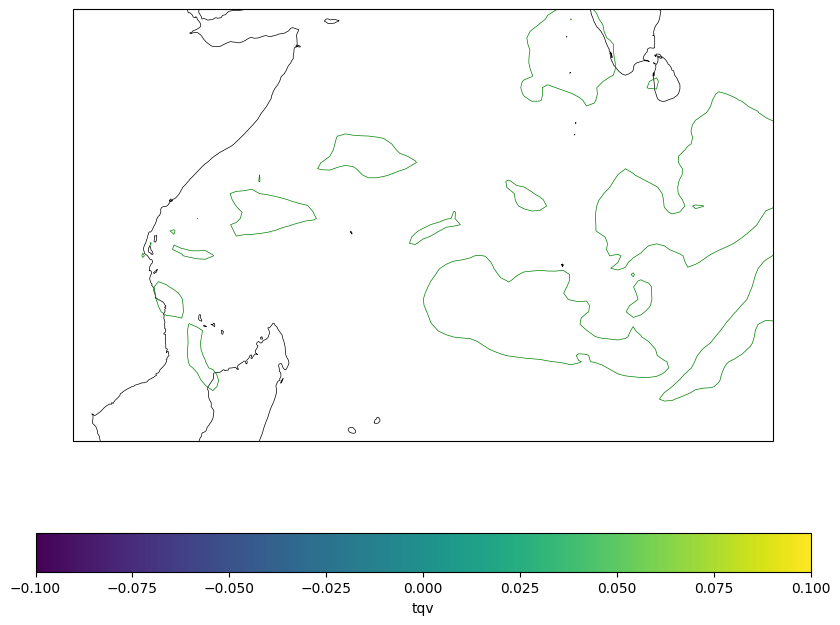

In [26]:
animate_field(9,'tqv')

In [ ]:
for i in range(len(list_of_minimal_cases)):
    animate_field(i,'tqv')

In [ ]:
def animate_field(field_number, variable):
    dataset = xr.open_dataset(minimal_cases_path + list_of_minimal_cases[field_number])
    
    lons = dataset['lon']
    lats = dataset['lat']
  
    fig, ax = plt.subplots(figsize=(10, 8), subplot_kw={'projection': ccrs.LambertCylindrical(central_longitude=0.0)})
    ax.set_extent([lons.min(), lons.max(), lats.min(), lats.max()], ccrs.PlateCarree())
    ax.coastlines(linewidths=0.5)
    
    mesh = ax.pcolormesh(lons, lats, dataset[variable][0, :, :].data, transform=ccrs.PlateCarree())
    cbar_mesh = plt.colorbar(mesh, ax=ax, orientation='horizontal', label=variable)  # label added
    
    # Thinner contour lines
    contour_distance = ax.contour(lons, lats, dataset['tqv'][0, :, :].data, colors='r', linewidths=0.5, levels = [55])
    contour_center = ax.contour(lons, lats, dataset['distance'][0, :, :].data, colors='black', linewidths=1, levels = [1])
    #plt.clabel(contour_distance, inline=True, fontsize=8)  # smaller font size
    
    slice_factor = 5
    U = np.cos(np.deg2rad(dataset['dir_from_centroid'][0, ::slice_factor, ::slice_factor].data))
    V = np.sin(np.deg2rad(dataset['dir_from_centroid'][0, ::slice_factor, ::slice_factor].data))
    #quiver = ax.quiver(lons[::slice_factor], lats[::slice_factor], U, V, transform=ccrs.PlateCarree(), scale=20, color='b')
    
    def animate(i):
        nonlocal contour_distance
        mesh.set_array(dataset[variable][i, :, :].data.flatten())
        
        for c in contour_distance.collections:
            c.remove()
        
        contour_distance = ax.contour(lons, lats, dataset['tqv'][i, :, :].data, colors='r', linewidths=0.5, levels = [55])
        contour_center = ax.contour(lons, lats, dataset['distance'][i, :, :].data, colors='black', linewidths=1, levels = [1])
        #plt.clabel(contour_distance, inline=True, fontsize=8)  # smaller font size
        
        #quiver.set_UVC(np.cos(np.deg2rad(dataset['dir_from_centroid'][i, ::slice_factor, ::slice_factor].data)), np.sin(np.deg2rad(dataset['dir_from_centroid'][i, ::slice_factor, ::slice_factor].data)))

        # Dynamic title
        case_name = list_of_minimal_cases[field_number].split('.')[0]  # Remove file extension
        ax.set_title(f"Case: {case_name}  Time: {i} hours")

    anim = animation.FuncAnimation(fig, animate, frames=79, interval=500)
    anim.save('/home/snigdha/box/VaporLakes/animate_merra2/animate_'+list_of_minimal_cases[field_number]+'.gif', writer='pillow', fps=5)
    return
    #return HTML(anim.to_jshtml())


In [ ]:
for i in range(len(list_of_minimal_cases)):
    animate_field(i,'tqv')

/home/snigdha/anaconda3/envs/basic/lib/python3.11/site-packages/matplotlib/contour.py:1454: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/home/snigdha/anaconda3/envs/basic/lib/python3.11/site-packages/matplotlib/contour.py:1455: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())


ValueError: For X (64) and Y (60) with flat shading, A should have shape (59, 63, 3) or (59, 63, 4) or (59, 63) or (3717,), not (3168,)

Error in callback <function _draw_all_if_interactive at 0x7f5bfea8a8e0> (for post_execute):


ValueError: For X (64) and Y (60) with flat shading, A should have shape (59, 63, 3) or (59, 63, 4) or (59, 63) or (3717,), not (3168,)

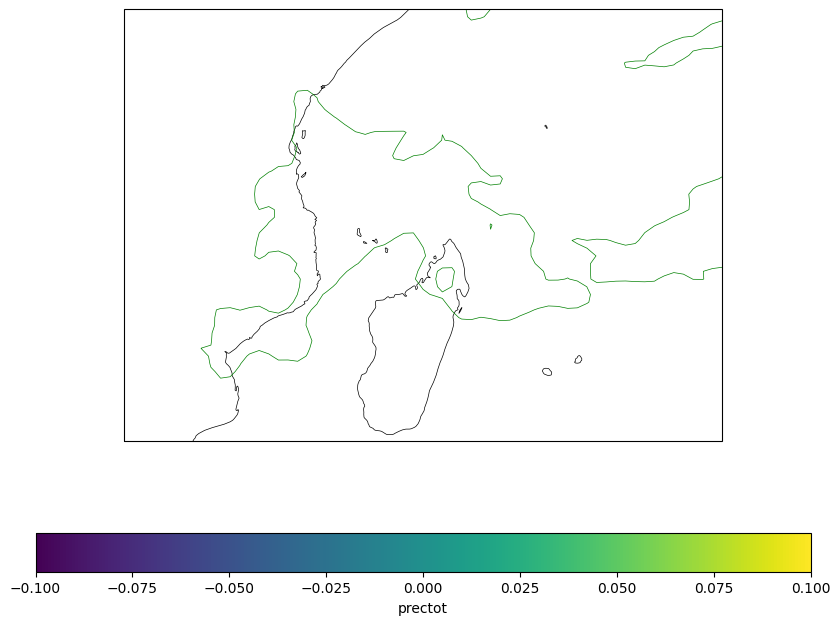

In [104]:
animate_field(18,'prectot')

## Task 2:
### IMERGprecip.groupby(distance from contour).mean() 
### AMSR2.cwv.groupby(distance).mean() w/min. time gaps

In [ ]:
imerg_path = '/home/snigdha/Documents/LAKEBYLAKE/IMERG/'
minimal_cases_path = '/home/snigdha/Documents/LAKEBYLAKE/MERRA2_2D/MINIMAL/'

In [ ]:
dataset_imerg = xr.open_dataset(imerg_path + '2014_04_12_21_lat5p095N_IMERG_precipc_hourly.nc')
dataset_merra = xr.open_dataset(minimal_cases_path + '2014_04_12_21_lat5p095N.M2_min2D_distance.nc')

In [ ]:
dataset_imerg

In [ ]:
dataset_merra

In [ ]:
output_directory_path='/home/snigdha/box/VaporLakes/data/LAKEBYLAKE/remapped_imerg/'

In [ ]:
dataset_imerg = xr.open_dataset(imerg_path + '2018_11_20_11_lat4p616S_IMERG_precipc_hourly.nc')

In [ ]:
dataset_imerg

In [ ]:
dataset_remapped = xr.open_dataset('/home/snigdha/workspace/2014_04_12_21_lat5p095N_remapped.nc')

In [ ]:
dataset_remapped

In [ ]:
list_of_remapped_imerg_files = [f for f in listdir('/home/snigdha/workspace/') if isfile(join('/home/snigdha/workspace/', f))]

In [ ]:
list_of_remapped_imerg_files.remove('remap_files.sh')

In [ ]:
list_of_remapped_imerg_files

In [ ]:
for i in range(len(list_of_remapped_imerg_files)):
    file_prefix = list_of_remapped_imerg_files[i][:23]
    merra_data = xr.open_dataset(minimal_cases_path + file_prefix + '.M2_min2D_distance.nc')
    imerg_data = xr.open_dataset(imerg_path + file_prefix + '_IMERG_precipc_hourly.nc')
    remapped_data = xr.open_dataset('/home/snigdha/workspace/'+ list_of_remapped_imerg_files[i])
    print('the file number =' +str(i))
    print('dimensions of remapped data are time: '+ str(remapped_data.dims['time']) + ', lat: '+ str(remapped_data.dims['lat']) + ', lon: '+ str(remapped_data.dims['lon']) )
    print('dimensions of merra data are time: '+ str(merra_data.dims['time']) + ', lat: '+ str(merra_data.dims['lat']) + ', lon: '+ str(merra_data.dims['lon']) )
    print('dimensions of imerg data are time: '+ str(imerg_data.dims['time']) + ', lat: '+ str(imerg_data.dims['lat']) + ', lon: '+ str(imerg_data.dims['lon']) )

    

### Remapping IMERG onto MERRA grid and plotting

In [10]:
remapped_data_merra = xr.open_dataset('/home/snigdha/workspace/2014_04_12_21_lat5p095N_remapped.nc')


In [11]:
original_merra_data = xr.open_dataset('/home/snigdha/Documents/LAKEBYLAKE/MERRA2_2D/MINIMAL/2014_04_12_21_lat5p095N.M2_min2D_distance.nc')

In [12]:
original_imerg_data =  xr.open_dataset('/home/snigdha/Documents/LAKEBYLAKE/IMERG/2014_04_12_21_lat5p095N_IMERG_precipc_hourly.nc')

In [13]:
original_imerg_data


<xarray.Dataset>
Dimensions:  (lat: 217, lon: 449, time: 173)
Coordinates:
  * time     (time) datetime64[ns] 2014-04-05T17:00:00 ... 2014-04-12T21:00:00
  * lat      (lat) float64 -3.95 -3.85 -3.75 -3.65 ... 17.35 17.45 17.55 17.65
  * lon      (lon) float64 44.45 44.55 44.65 44.75 ... 88.95 89.05 89.15 89.25
Data variables:
    precipc  (time, lat, lon) float32 ...

In [17]:
original_imerg_data.precipc

<xarray.DataArray 'precipc' (time: 173, lat: 217, lon: 449)>
array([[[2.817509e+20, 2.070117e-19, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        ...,
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00]],

       [[0.000000e+00, 0.000000e+00, ..., 9.166199e-01, 1.838591e-01],
        [1.881717e-01, 1.962234e-38, ..., 0.000000e+00, 0.000000e+00],
        ...,
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00]],

       ...,

       [[0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        ...,
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00]],

       [[0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        ...,
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00],
        [0.000000e+00, 0.000000e+00, ..., 0.000000e+00, 0.000000e+00]]],
      dtype=float32)
Coordinates:
  * time     (time) datetime64[ns] 2014-04-05T17:00:00 ... 2014-04-12T21:00:00
  * lat      (lat) float64 -3.95 -3.85 -3.75 -3.65 ... 17.35 17.45 17.55 17.65
  * lon      (lon) float64 44.45 44.55 44.65 44.75 ... 88.95 89.05 89.15 89.25
Attributes:
    long_name:  precipitationcal [mm/hr]

In [18]:
remapped_data_merra

<xarray.Dataset>
Dimensions:            (lat: 217, lon: 449, time: 172)
Coordinates:
  * time               (time) datetime64[ns] 2014-04-05T17:30:00 ... 2014-04-...
  * lon                (lon) float64 44.45 44.55 44.65 ... 89.05 89.15 89.25
  * lat                (lat) float64 -3.95 -3.85 -3.75 ... 17.45 17.55 17.65
Data variables:
    prectot            (time, lat, lon) float32 ...
    tqv                (time, lat, lon) float32 ...
    distance           (time, lat, lon) float32 ...
    dir_from_centroid  (time, lat, lon) float32 ...
Attributes:
    CDI:          Climate Data Interface version 2.2.4 (https://mpimet.mpg.de...
    Conventions:  COARDS\nGrADS
    title:        MERRA-2 tavg1_2d_flx_Nx: 2d,1-Hourly,Time-Averaged,Single-L...
    dataType:     Grid
    history:      Wed Sep 06 14:52:17 2023: cdo -remapcon,/home/snigdha/Docum...
    CDO:          Climate Data Operators version 2.2.2 (https://mpimet.mpg.de...

In [19]:
original_imerg_data

<xarray.Dataset>
Dimensions:  (lat: 217, lon: 449, time: 173)
Coordinates:
  * time     (time) datetime64[ns] 2014-04-05T17:00:00 ... 2014-04-12T21:00:00
  * lat      (lat) float64 -3.95 -3.85 -3.75 -3.65 ... 17.35 17.45 17.55 17.65
  * lon      (lon) float64 44.45 44.55 44.65 44.75 ... 88.95 89.05 89.15 89.25
Data variables:
    precipc  (time, lat, lon) float32 2.818e+20 2.07e-19 1.356e-19 ... 0.0 0.0

In [20]:
remapped_data_merra

<xarray.Dataset>
Dimensions:            (lat: 217, lon: 449, time: 172)
Coordinates:
  * time               (time) datetime64[ns] 2014-04-05T17:30:00 ... 2014-04-...
  * lon                (lon) float64 44.45 44.55 44.65 ... 89.05 89.15 89.25
  * lat                (lat) float64 -3.95 -3.85 -3.75 ... 17.45 17.55 17.65
Data variables:
    prectot            (time, lat, lon) float32 ...
    tqv                (time, lat, lon) float32 ...
    distance           (time, lat, lon) float32 ...
    dir_from_centroid  (time, lat, lon) float32 ...
Attributes:
    CDI:          Climate Data Interface version 2.2.4 (https://mpimet.mpg.de...
    Conventions:  COARDS\nGrADS
    title:        MERRA-2 tavg1_2d_flx_Nx: 2d,1-Hourly,Time-Averaged,Single-L...
    dataType:     Grid
    history:      Wed Sep 06 14:52:17 2023: cdo -remapcon,/home/snigdha/Docum...
    CDO:          Climate Data Operators version 2.2.2 (https://mpimet.mpg.de...

In [21]:
original_imerg_data_interp = original_imerg_data.interp(time=remapped_data_merra['time'])

/home/snigdha/anaconda3/envs/basic/lib/python3.11/site-packages/xarray/core/missing.py:559: FutureWarning: Passing method to DatetimeIndex.get_loc is deprecated and will raise in a future version. Use index.get_indexer([item], method=...) instead.
  imin = index.get_loc(minval, method="nearest")
/home/snigdha/anaconda3/envs/basic/lib/python3.11/site-packages/xarray/core/missing.py:560: FutureWarning: Passing method to DatetimeIndex.get_loc is deprecated and will raise in a future version. Use index.get_indexer([item], method=...) instead.
  imax = index.get_loc(maxval, method="nearest")


In [22]:
original_imerg_data_interp

<xarray.Dataset>
Dimensions:  (lat: 217, lon: 449, time: 172)
Coordinates:
  * lat      (lat) float64 -3.95 -3.85 -3.75 -3.65 ... 17.35 17.45 17.55 17.65
  * lon      (lon) float64 44.45 44.55 44.65 44.75 ... 88.95 89.05 89.15 89.25
  * time     (time) datetime64[ns] 2014-04-05T17:30:00 ... 2014-04-12T20:30:00
Data variables:
    precipc  (time, lat, lon) float64 1.409e+20 1.035e-19 6.778e-20 ... 0.0 0.0

In [23]:
merged_ds = xr.merge([original_imerg_data_interp, remapped_data_merra])

In [24]:
merged_ds

<xarray.Dataset>
Dimensions:            (lat: 217, lon: 449, time: 172)
Coordinates:
  * lat                (lat) float64 -3.95 -3.85 -3.75 ... 17.45 17.55 17.65
  * lon                (lon) float64 44.45 44.55 44.65 ... 89.05 89.15 89.25
  * time               (time) datetime64[ns] 2014-04-05T17:30:00 ... 2014-04-...
Data variables:
    precipc            (time, lat, lon) float64 1.409e+20 1.035e-19 ... 0.0 0.0
    prectot            (time, lat, lon) float32 ...
    tqv                (time, lat, lon) float32 ...
    distance           (time, lat, lon) float32 ...
    dir_from_centroid  (time, lat, lon) float32 ...

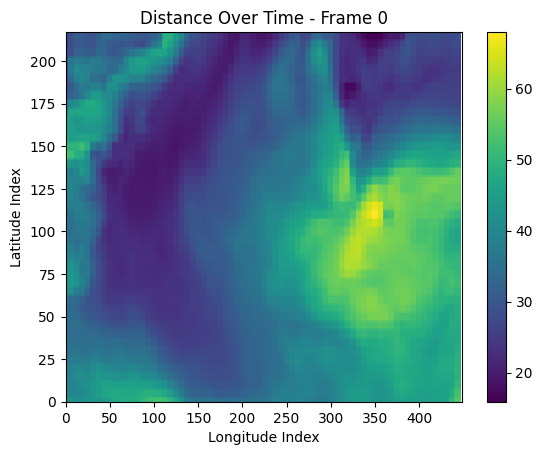

In [25]:
# Initialize the plot
fig, ax = plt.subplots()
cax = ax.pcolormesh(merged_ds['precipc'][0, :, :])
cbar = fig.colorbar(cax)
plt.xlabel('Longitude Index')
plt.ylabel('Latitude Index')
plt.title('Distance Over Time')

# Animation update function
def update(frame):
    ax.clear()
    cax = ax.pcolormesh(merged_ds['tqv'][frame, :, :])
    plt.xlabel('Longitude Index')
    plt.ylabel('Latitude Index')
    plt.title(f'Distance Over Time - Frame {frame}')

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=len(merged_ds['time']), repeat=False)

# Display the animation
HTML(ani.to_jshtml())

In [26]:
import numpy as np
from scipy.stats import binned_statistic
import xarray as xr

def calculate_time_averaged_precipitation(dataset):
    """
    Calculate time-averaged precipitation based on distance bins.

    Parameters:
    - dataset: xarray.Dataset

    Returns:
    - time_averaged_precipitation: NumPy array
    """

    # Extract the data variables as numpy arrays
    distance_array = dataset['distance'].values
    precipc_array = dataset['precipc'].values

    # Define distance bins (you may customize this as needed)
    min_distance = np.nanmin(distance_array)  # Using nanmin to ignore NaNs
    max_distance = np.nanmax(distance_array)  # Using nanmax to ignore NaNs
    distance_bins = np.linspace(min_distance, max_distance, 20)  # 10 bins

    # Initialize a list to store the mean precipc values for each time step
    time_averaged_precipitation = []

    # Loop through the time dimension
    for t in range(precipc_array.shape[0]):
        # Extract 2D arrays for the current time step and flatten them
        current_distance = distance_array[t, :, :].flatten()
        current_precipc = precipc_array[t, :, :].flatten()

        # Remove pairs where either distance or precipc is NaN
        mask = ~np.isnan(current_distance) & ~np.isnan(current_precipc)
        filtered_distance = current_distance[mask]
        filtered_precipc = current_precipc[mask]

        # Perform the binning and averaging using scipy's binned_statistic
        bin_means, bin_edges, binnumber = binned_statistic(
            filtered_distance, filtered_precipc, statistic='mean', bins=distance_bins
        )

        # Append the binned and averaged data to our list
        time_averaged_precipitation.append(bin_means)

    return np.array(time_averaged_precipitation)

# To run the function, load your xarray dataset and call it like so:
# ds = xr.open_dataset("your_file.nc")
# result = calculate_time_averaged_precipitation(ds)


In [27]:
time_avg_precip = calculate_time_averaged_precipitation(merged_ds)

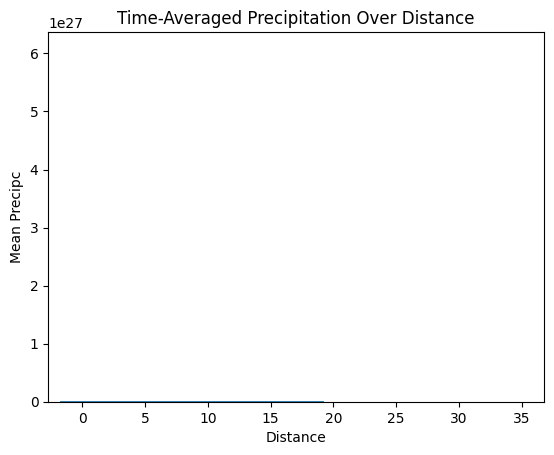

In [28]:
# Get min and max distance from the dataset
# Assuming ds is your xarray dataset and 'distance' is your distance variable
min_distance = float(np.nanmin(merged_ds['distance'].values))  # Convert to float to handle NumPy float type
max_distance = float(np.nanmax(merged_ds['distance'].values))

# Create distance bins dynamically
distance_bins = np.linspace(min_distance, max_distance, 20)  # Replace 10 with your actual number of bins
bin_centers = (distance_bins[:-1] + distance_bins[1:]) / 2

# Initialize plot
fig, ax = plt.subplots()
line, = ax.plot([], [], lw=2)
ax.set_xlim(min_distance, max_distance)
ax.set_ylim(0, np.nanmax(time_avg_precip))  # Assuming time_averaged_precipitation is your data
ax.set_xlabel("Distance")
ax.set_ylabel("Mean Precipc")
plt.title("Time-Averaged Precipitation Over Distance")

# Initialization function for animation
def init():
    line.set_data([], [])
    return line,

# Animation function
def animate(i):
    y = time_avg_precip[i]
    line.set_data(bin_centers, y)
    return line,

# Create animation
ani = animation.FuncAnimation(fig, animate, init_func=init,
                              frames=time_avg_precip.shape[0]-100, blit=True)

# To view the animation inline (for Jupyter Notebook)
# from IPython.display import HTML
HTML(ani.to_jshtml())

# To save the animation
#ani.save("time_averaged_precipitation.mp4", writer="ffmpeg")

#plt.show()


## A different way of groupby

In [31]:
merged_ds

<xarray.Dataset>
Dimensions:            (lat: 217, lon: 449, time: 172)
Coordinates:
  * lat                (lat) float64 -3.95 -3.85 -3.75 ... 17.45 17.55 17.65
  * lon                (lon) float64 44.45 44.55 44.65 ... 89.05 89.15 89.25
  * time               (time) datetime64[ns] 2014-04-05T17:30:00 ... 2014-04-...
Data variables:
    precipc            (time, lat, lon) float64 1.409e+20 1.035e-19 ... 0.0 0.0
    prectot            (time, lat, lon) float32 ...
    tqv                (time, lat, lon) float32 ...
    distance           (time, lat, lon) float32 10.29 10.29 10.26 ... nan nan
    dir_from_centroid  (time, lat, lon) float32 ...

(array([3032962., 4804962., 4061004., 1685050., 1003765.,  802970.,
         504190.,  440519.,  299509.,   48897.]),
 array([-2.7332716 ,  1.21926355,  5.17179871,  9.12433434, 13.07686901,
        17.02940369, 20.98193932, 24.93447495, 28.88700867, 32.8395462 ,
        36.79207993]),
 <BarContainer object of 10 artists>)

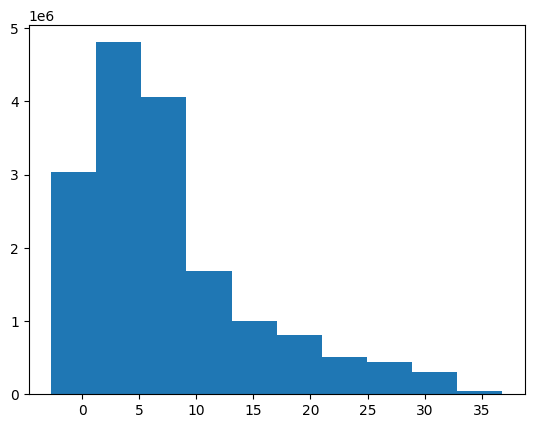

In [64]:
plt.hist(merged_ds['distance'].values.flatten())

In [65]:
def distance_based_spatial_average(ds, bin_width):
    """
    Perform distance-based binning and spatial averaging on an xarray.Dataset.

    Parameters:
        ds (xarray.Dataset): The input dataset.
        bin_width (float): The width of each distance bin.

    Returns:
        xarray.Dataset: A new dataset containing spatial averages of each variable,
                        grouped by distance bins.
    """

    # Find minimum and maximum distance ignoring NaNs
    min_distance = ds['distance'].min(skipna=True).values
    max_distance = ds['distance'].max(skipna=True).values

    # Create distance bins dynamically
    bin_edges = np.arange(min_distance, max_distance + bin_width, bin_width)
    print(bin_edges)
    # Use pandas cut for binning
    distance_bins = pd.cut(ds['distance'].values.flatten(), bins=bin_edges, labels=False)
    distance_bins = xr.DataArray(distance_bins.reshape(ds['distance'].shape), coords=ds['distance'].coords, dims=ds['distance'].dims)

    # Add new coordinate for distance bins
    ds['distance_bin'] = distance_bins

    # Group by distance bins and calculate spatial average for each group
    grouped = ds.groupby('distance_bin')
    print(grouped)

    # Create a list to hold the new DataArrays
    new_vars = []

    for var in ds.data_vars:
        if var != 'distance':  # Skip the 'distance' variable itself
            avg_data = grouped[var].mean(dim=['lat', 'lon'])
            new_vars.append(avg_data)

    # Combine the new DataArrays into a new Dataset
    avg_ds = xr.merge(new_vars)

    return avg_ds


In [69]:
grouped.dim

AttributeError: 'DatasetGroupBy' object has no attribute 'dim'

In [66]:
distance_based_spatial_average(merged_ds,2)

[-2.7332716 -0.7332716  1.2667284  3.2667284  5.2667284  7.2667284
  9.2667284 11.2667284 13.2667284 15.2667284 17.2667284 19.2667284
 21.2667284 23.2667284 25.2667284 27.2667284 29.2667284 31.2667284
 33.2667284 35.2667284 37.2667284]
DatasetGroupBy, grouped over 'distance_bin'
20 groups with labels 0.0, 1.0, 2.0, ..., 17.0, 18.0, 19.0.


KeyError: 'precipc'

In [70]:
min_distance = merged_ds['distance'].min(skipna=True).values
max_distance = merged_ds['distance'].max(skipna=True).values

bin_width = 0.2
# Create distance bins dynamically
bin_edges = np.arange(min_distance, max_distance + bin_width, bin_width)
print(bin_edges)

[-2.7332716 -2.5332716 -2.3332716 -2.1332716 -1.9332716 -1.7332716
 -1.5332716 -1.3332716 -1.1332716 -0.9332716 -0.7332716 -0.5332716
 -0.3332716 -0.1332716  0.0667284  0.2667284  0.4667284  0.6667284
  0.8667284  1.0667284  1.2667284  1.4667284  1.6667284  1.8667284
  2.0667284  2.2667284  2.4667284  2.6667284  2.8667284  3.0667284
  3.2667284  3.4667284  3.6667284  3.8667284  4.0667284  4.2667284
  4.4667284  4.6667284  4.8667284  5.0667284  5.2667284  5.4667284
  5.6667284  5.8667284  6.0667284  6.2667284  6.4667284  6.6667284
  6.8667284  7.0667284  7.2667284  7.4667284  7.6667284  7.8667284
  8.0667284  8.2667284  8.4667284  8.6667284  8.8667284  9.0667284
  9.2667284  9.4667284  9.6667284  9.8667284 10.0667284 10.2667284
 10.4667284 10.6667284 10.8667284 11.0667284 11.2667284 11.4667284
 11.6667284 11.8667284 12.0667284 12.2667284 12.4667284 12.6667284
 12.8667284 13.0667284 13.2667284 13.4667284 13.6667284 13.8667284
 14.0667284 14.2667284 14.4667284 14.6667284 14.8667284 15.066

In [71]:
# Use pandas cut for binning
distance_bins = pd.cut(merged_ds['distance'].values.flatten(), bins=bin_edges, labels=False)
distance_bins = xr.DataArray(distance_bins.reshape(merged_ds['distance'].shape), coords=merged_ds['distance'].coords, dims=merged_ds['distance'].dims)

# Add new coordinate for distance bins
merged_ds['distance_bin'] = distance_bins

# Group by distance bins and calculate spatial average for each group
grouped = merged_ds.groupby('distance_bin')
print(grouped)

DatasetGroupBy, grouped over 'distance_bin'
198 groups with labels 0.0, 1.0, 2.0, ..., 196.0, 197.0.


In [73]:
# Initialize a new Dataset to store the results
avg_ds = xr.Dataset()

for var in merged_ds.data_vars:
    avg_ds[var] = grouped[var].mean(dim=['lat', 'lon'])

# Create a list to hold the new DataArrays
new_vars = []

for var in ds.data_vars:
    if var != 'distance':  # Skip the 'distance' variable itself
        avg_data = grouped[var].mean(dim=['lat', 'lon'])
        new_vars.append(avg_data)

# Combine the new DataArrays into a new Dataset
avg_ds = xr.merge(new_vars)

KeyError: 'precipc'

In [80]:
def distance_based_spatial_average(ds, bin_width):
    # Find minimum and maximum distance ignoring NaNs
    min_distance = float(ds['distance'].min(skipna=True))
    max_distance = float(ds['distance'].max(skipna=True))

    # Create distance bins dynamically
    bin_edges = np.arange(min_distance, max_distance + bin_width, bin_width)

    # Assign a bin to each 'distance' value in the dataset
    ds = ds.assign_coords(distance_bin = xr.DataArray(np.digitize(ds['distance'], bin_edges), coords=ds.coords))

    # Initialize an empty dictionary to collect the averaged data arrays
    avg_data_dict = {}

    # Group by 'distance_bin' and calculate mean for each group across lat and lon
    for var in ds.data_vars:
        if var != 'distance':  # Skip the 'distance' variable itself
            avg_data_dict[var] = ds[var].groupby('distance_bin').mean(dim=['lat', 'lon'])

    # Create a new Dataset from the averaged data arrays
    avg_ds = xr.Dataset(avg_data_dict)

    return avg_ds

# Example usage:
# bin_width = 2
# averaged_ds = distance_based_spatial_average(merged_ds, bin_width)


In [81]:
distance_based_spatial_average(merged_ds,2)

ValueError: conflicting sizes for dimension 'lat': length 172 on the data but length 217 on coordinate 'lat'

# A fresh start: IMERG and MERRA

In [82]:
remapped_data_merra = xr.open_dataset('/home/snigdha/workspace/2014_04_12_21_lat5p095N_remapped.nc')

In [83]:
remapped_data_merra

<xarray.Dataset>
Dimensions:            (lat: 217, lon: 449, time: 172)
Coordinates:
  * time               (time) datetime64[ns] 2014-04-05T17:30:00 ... 2014-04-...
  * lon                (lon) float64 44.45 44.55 44.65 ... 89.05 89.15 89.25
  * lat                (lat) float64 -3.95 -3.85 -3.75 ... 17.45 17.55 17.65
Data variables:
    prectot            (time, lat, lon) float32 ...
    tqv                (time, lat, lon) float32 ...
    distance           (time, lat, lon) float32 ...
    dir_from_centroid  (time, lat, lon) float32 ...
Attributes:
    CDI:          Climate Data Interface version 2.2.4 (https://mpimet.mpg.de...
    Conventions:  COARDS\nGrADS
    title:        MERRA-2 tavg1_2d_flx_Nx: 2d,1-Hourly,Time-Averaged,Single-L...
    dataType:     Grid
    history:      Wed Sep 06 14:52:17 2023: cdo -remapcon,/home/snigdha/Docum...
    CDO:          Climate Data Operators version 2.2.2 (https://mpimet.mpg.de...

In [ ]:
# Create an empty dictionary to hold new datasets for each time slice
new_datasets = {}

# Create your bins using numpy's arange
bins = np.arange(-2, 4, 0.1)


# Loop through each time slice
for t in merged_ds['time']:
    # Select the time slice from the original dataset
    ds_t = merged_ds.sel(time=t)
    
    # Unstack into 'lat' and 'lon' if they are stacked
    if 'stacked_lat_lon' in ds_t.dims:
        ds_t = ds_t.unstack('stacked_lat_lon')
    
    # Group by 'distance' and calculate the mean along 'lat' and 'lon'
    ds_grouped = ds_t.groupby_bins('distance', bins=bins).mean(dim=['lat', 'lon'])
    
    # Store this new dataset in the dictionary
    new_datasets[t.values] = ds_grouped

In [ ]:
# Create an empty dictionary to store the new datasets for each time slice
new_datasets = {}

# Loop through each unique time in the dataset
for t in merged_ds['time'].values:
    # Slice the dataset for that specific time
    ds_t = merged_ds.sel(time=t)
    
    # Perform the groupby_bins operation for that time slice
    ds_grouped_t = ds_t.groupby_bins('distance', bins=np.arange(-2, 4, 0.1))

    one_group = list(ds_grouped_t)[0][1]
    print(one_group.dims)
    
    # Create an empty dataset to hold the reduced data
    ds_reduced_t = xr.Dataset()
    
    # Loop through each group and reduce along the combined dimension 'stacked_lat_lon'

    for name, group in ds_grouped_t:
        reduced_data_array = group.mean(dim='stacked_lat_lon').to_array()
        ds_reduced_t[str(name)] = reduced_data_array  # Convert bin name to a string

    new_datasets[t] = ds_reduced_t
